# Comportamiento de las Redes Convolucionales

In [1]:
import os
try:
    from google.colab import drive
    COLAB = True
    print("Estoy en Google CoLab")
except:
    os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
    os.environ["CUDA_VISIBLE_DEVICES"]="1"
    print("No estoy en Google CoLab")
    COLAB = False

No estoy en Google CoLab


In [2]:
import tensorflow as tf
import matplotlib
import urllib
import numpy as np
import random
import urllib
import os
%matplotlib inline
import matplotlib.pyplot as plt
import cv2

In [3]:
def show_images(*args, tags=None):
    n = len(args[0])
    plt.figure(figsize=(20, 4*len(args)))
    for i in range(n):
        for j in range(len(args)):
            data = args[j][i]
            img = data['image']
            ax = plt.subplot(len(args), n, i + 1 + j*n)
            cmap = None if 'cmap' not in data else data['cmap']

            if len(img.shape) == 3 and img.shape[2] == 1:
                ax.imshow(img.reshape(img.shape[:2]), cmap=cmap)
            else:
                ax.imshow(img, cmap=cmap)

            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            if 'tag' in data:
                tags = data['tag']
                n_lines = len(tags.split('\n'))
                ax.text(0.0,-0.1 * n_lines, tags, size=12,
                        ha="left", transform=ax.transAxes)

    plt.show()

Actualmente, existe un problema importante en el mundo de las redes convolucionales que no ha sido fácil de resolver: la **opacidad** de estos modelos. Debido a esta opacidad, a menudo se dice que los modelos de *deep learning* (DL) son *cajas negras*. En otras palabras, no es sencillo **interpretar** cómo utiliza la red las características aprendidas para llevar a cabo la tarea para la que ha sido entrenada.

Esta dificultad para interpretar lo que un modelo ha aprendido tiene varias consecuencias. En ciertas áreas, la interpretabilidad es fundamental. Un ejemplo claro de esta problemática se da en las **aplicaciones médicas**, donde no solo se requiere un modelo eficiente, sino también comprender las razones detrás de sus respuestas. Las consecuencias de un error pueden ser muy graves, y confiar decisiones críticas a un sistema opaco genera, como mínimo, desconfianza.

En esta línea, la **Comisión Europea**, en 2018, publicó una comunicación en la que enfatizaba la importancia de la interpretabilidad en la investigación en inteligencia artificial, especialmente para **generar confianza** en estos sistemas:

> *"Los sistemas basados en inteligencia artificial deberían ser diseñados y desarrollados de manera que permita a los humanos comprender en qué se basan sus decisiones, con el fin de incrementar la transparencia y reducir el riesgo de error por sesgo."*

Un ejemplo donde esta falta de transparencia ha generado gran desconfianza es en las aplicaciones judiciales, donde pueden aparecer **sesgos raciales** en las decisiones automatizadas.

Además, tener una idea clara de cómo está funcionando una red puede ayudar a los desarrolladores a **identificar errores**, entender por qué falla en ciertas muestras e incluso **protegerla ante ataques adversarios** que buscan inducir comportamientos erróneos.

A pesar de que los modelos DL son considerados cajas negras, sus representaciones jerárquicas aprendidas permiten ofrecer interpretaciones visuales bastante informativas sobre lo que han aprendido las capas convolucionales. Desde 2013, se han propuesto numerosas técnicas para **visualizar e interpretar** estas representaciones, y en este tema abordaremos algunas de las más representativas y accesibles.

Concretamente, en este *notebook* vamos a ver cómo **visualizar las salidas de las capas intermedias** (*activaciones intermedias*). Útil para comprender cómo las sucesivas capas transforman sus entradas y para tener una idea inicial de la funcionalidad de los filtros convolucionales individuales.


---

En este tema exploraremos distintos métodos de visualización. Para el primer método, usaremos la pequeña red que entrenamos desde cero para reconocer gatos y perros. Para los otros dos métodos, utilizaremos el modelo **VGG16 preentrenado**, que ya hemos usado anteriormente.


## Visualizando Activaciones Intermedias (feature maps)

Visualizar las activaciones intermedias consiste en mostrar el mapa de características que conforman las salidas de las diferentes capas de convolución y pooling de la red para una determinada entrada (la salida de una capa a menudo se llama su **activación**, por ser la salida de su función de activación).

Este procedimiento da una visión sobre cómo una entrada es descompuesta por las distintas capas aprendidas por la red, y no solo se puede hacer con redes convolucionales sino con cualquier tipo de capa, aunque sea en estas redes donde la interpretación visual es más directa. En este caso, los mapas de características tienen 3 dimensiones: anchura, altura y profundidad (canales). Cada canal codifica características relativamente independientes, por lo que la forma más apropiada de visualizar estas características es también representar independientemente los contenidos de cada canal como imágenes 2D.

Para ponerlo en práctica usaremos una VGG16 entrenada con ImageNet:

In [4]:

model = tf.keras.applications.VGG16(weights='imagenet', input_shape=(96, 96, 3), include_top=False)
model.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 96, 96, 3)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 96, 96, 64)     │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 96, 96, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 48, 48, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 48, 48, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 48, 48, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 24, 24, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 24, 24, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 12, 12, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 12, 12, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 12, 12, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 12, 12, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 6, 6, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 6, 6, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 3, 3, 512)      │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [5]:
model.input

<KerasTensor shape=(None, 96, 96, 3), dtype=float32, sparse=False, ragged=False, name=keras_tensor>

Vamos a cargar una imagen de prueba (para que no haya correlación con el aprendizaje llevado a cabo, esta imagen será parte de nuestro conjunto de test):

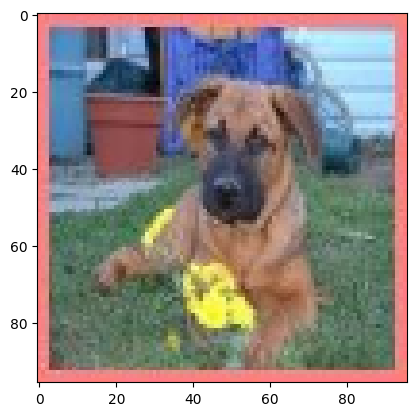

Expanded tensor shape (1, 96, 96, 3)


In [23]:
url_img = 'https://hdvirtual.us.es/discovirt/index.php/s/pNmfDgkEEN9M3cN/download'
urllib.request.urlretrieve(url_img, 'dog.1820.jpg')
img_path = 'dog.1820.jpg'


img_tensor = cv2.imread(img_path)
img_tensor = cv2.cvtColor(img_tensor, cv2.COLOR_BGR2RGB)  
img_tensor = cv2.resize(img_tensor, (96, 96))
plt.imshow(img_tensor)
plt.show()


img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor = tf.keras.applications.vgg16.preprocess_input(img_tensor)

# La forma ahora es (1, 150, 150, 3)
print('Expanded tensor shape', img_tensor.shape)



Hemos de tener en cuenta que Keras solo trabaja con modelos, y la información que estamos buscando son las activaciones internas de un modelo ya definido, que el propio no proporciona externamente. Por ello, y con el fin de extraer los mapas de características, vamos a crear un modelo adicional de Keras que toma batches de imágenes como entrada y devuelve las activaciones de todas las capas de convolución y pooling del modelo anteriormente entrenado.

Para ello, usaremos la api de Keras. Esto nos permitirá trabajar con múltiples salidas.

In [7]:
model.layers[3].output

<KerasTensor shape=(None, 48, 48, 64), dtype=float32, sparse=False, ragged=False, name=keras_tensor_3>

In [8]:
# Extrae las salidas de las 8 capas superiores:
layer_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]
# Crea un modelo que devuelva estas salidas a partir de la entrada:
activation_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)

Cuando a este modelo se le pasa una imagen de entrada, devuelve los valores de las activaciones de las 8 primeras capas del modelo original.


Por ejemplo, la activación de la primera capa convolucional sobre nuestra imagen, sería:


In [9]:
activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]
print(first_layer_activation.shape)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
(1, 96, 96, 64)


Un mapa de características de tamaño 224 x 224 con 64 canales. Visualicemos algunos de ellos por medio de las funciones de `matplotlib`:


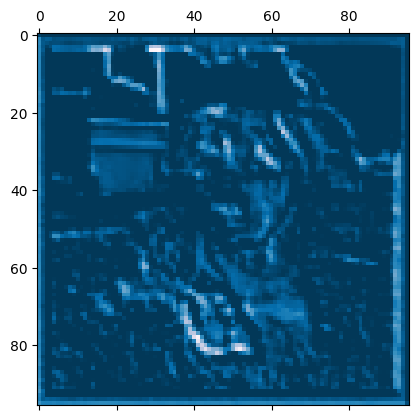

In [10]:
import matplotlib.pyplot as plt

plt.matshow(first_layer_activation[0, :, :, 7], cmap='PuBu_r')
plt.show()

Por ejemplo, el 6º canal sería:


In [11]:
first_layer_activation.shape

(1, 96, 96, 64)

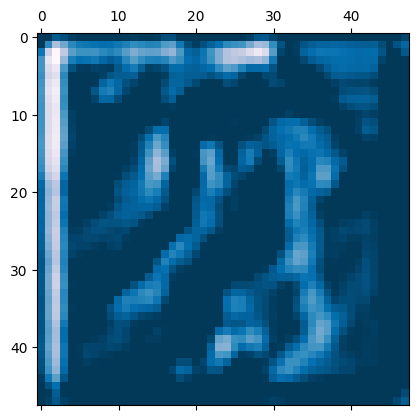

In [12]:
first_layer_activation = activations[3]
plt.matshow(first_layer_activation[0, :, :, 6], cmap='PuBu_r')
plt.show()

Si modificas el valor de la capa a la que accedes podrás observar las diferencias existentes entre los fitros aprendidos conforme se profundiza en la red.

Podemos mostrar una visualización completa de todas las activaciones de la red:

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


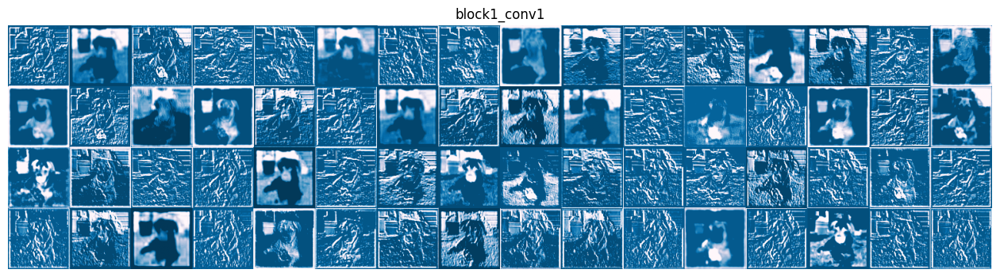

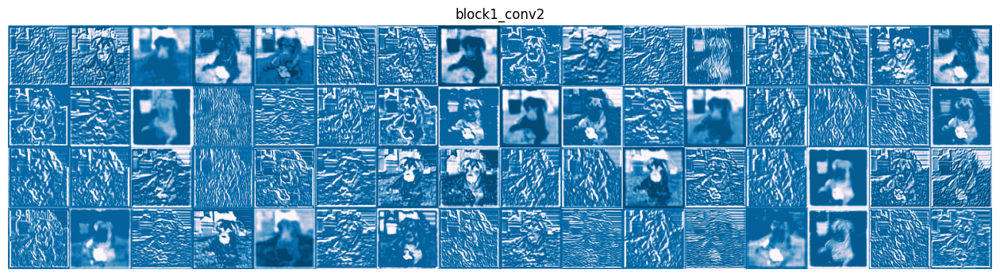

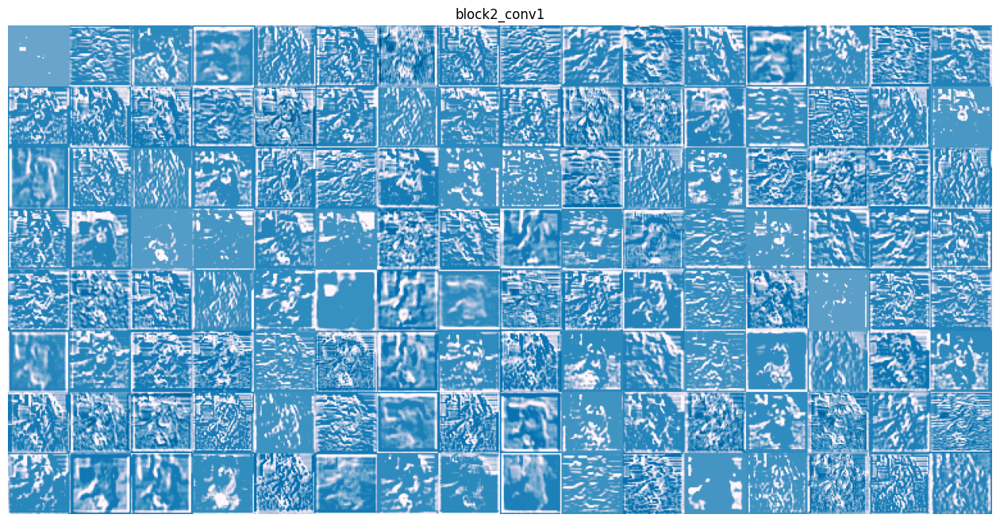

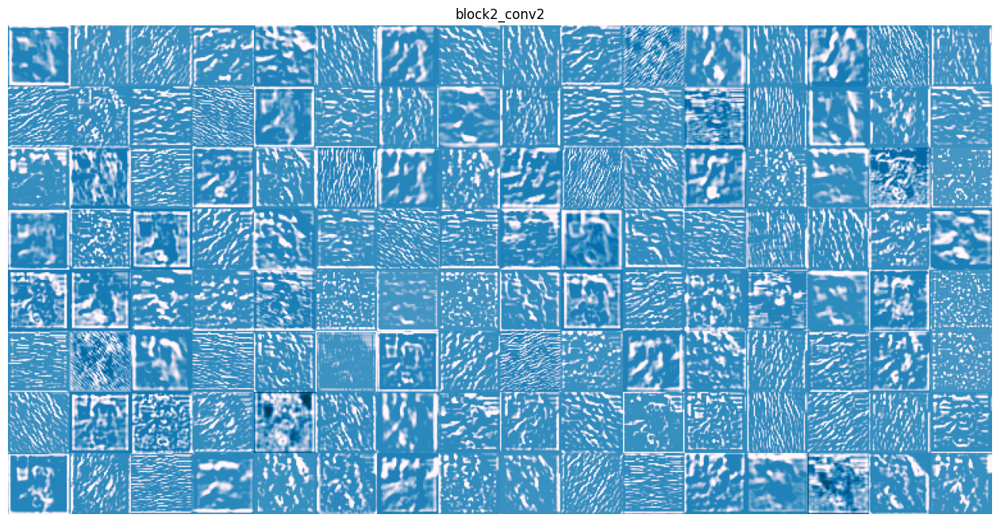

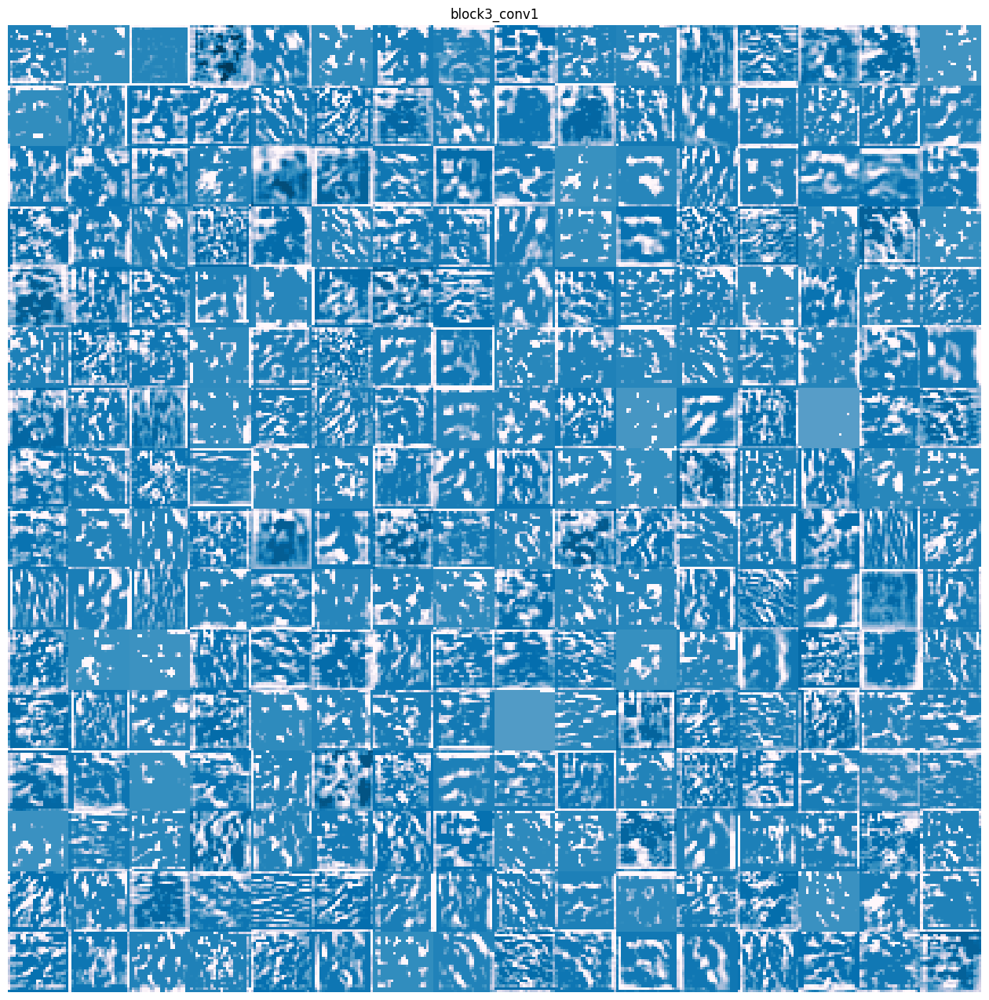

/var/folders/sl/6bh6kmv142759hyc6r3d8jqr0000gn/T/ipykernel_29319/1760294658.py:33: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
/var/folders/sl/6bh6kmv142759hyc6r3d8jqr0000gn/T/ipykernel_29319/1760294658.py:36: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


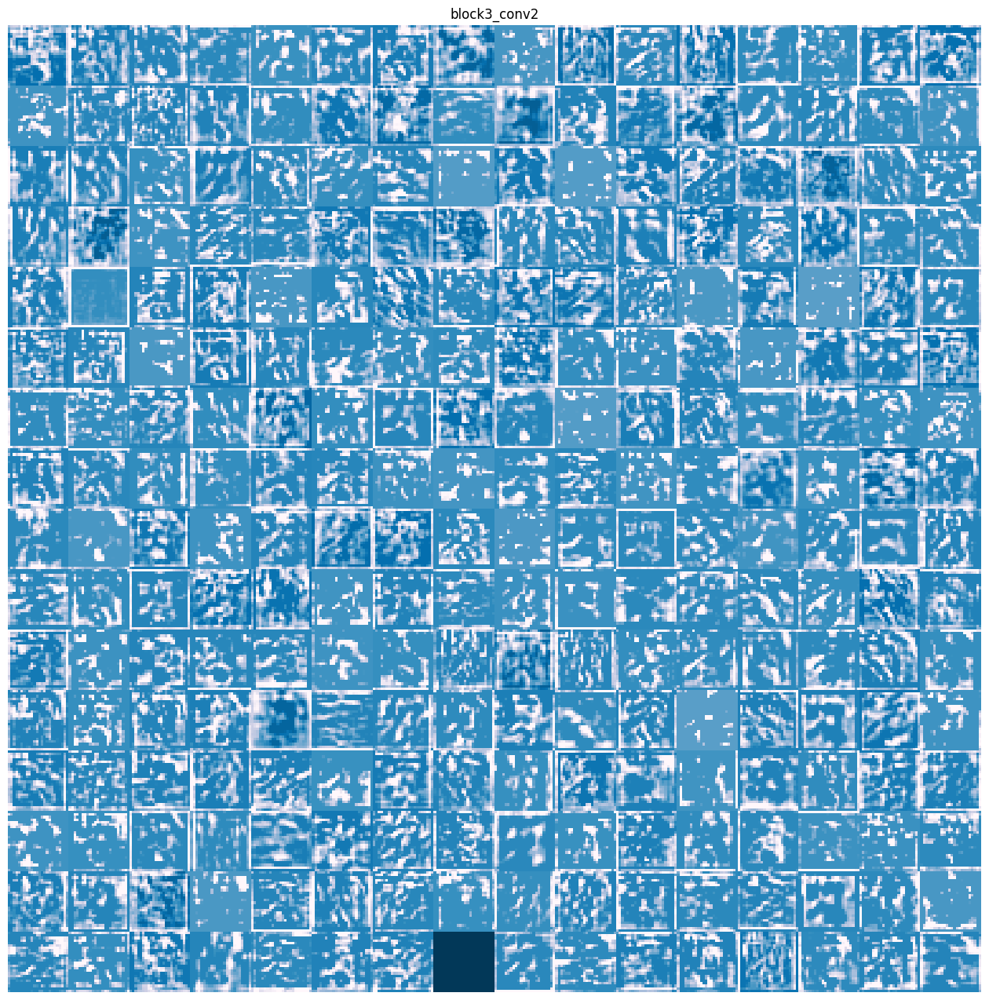

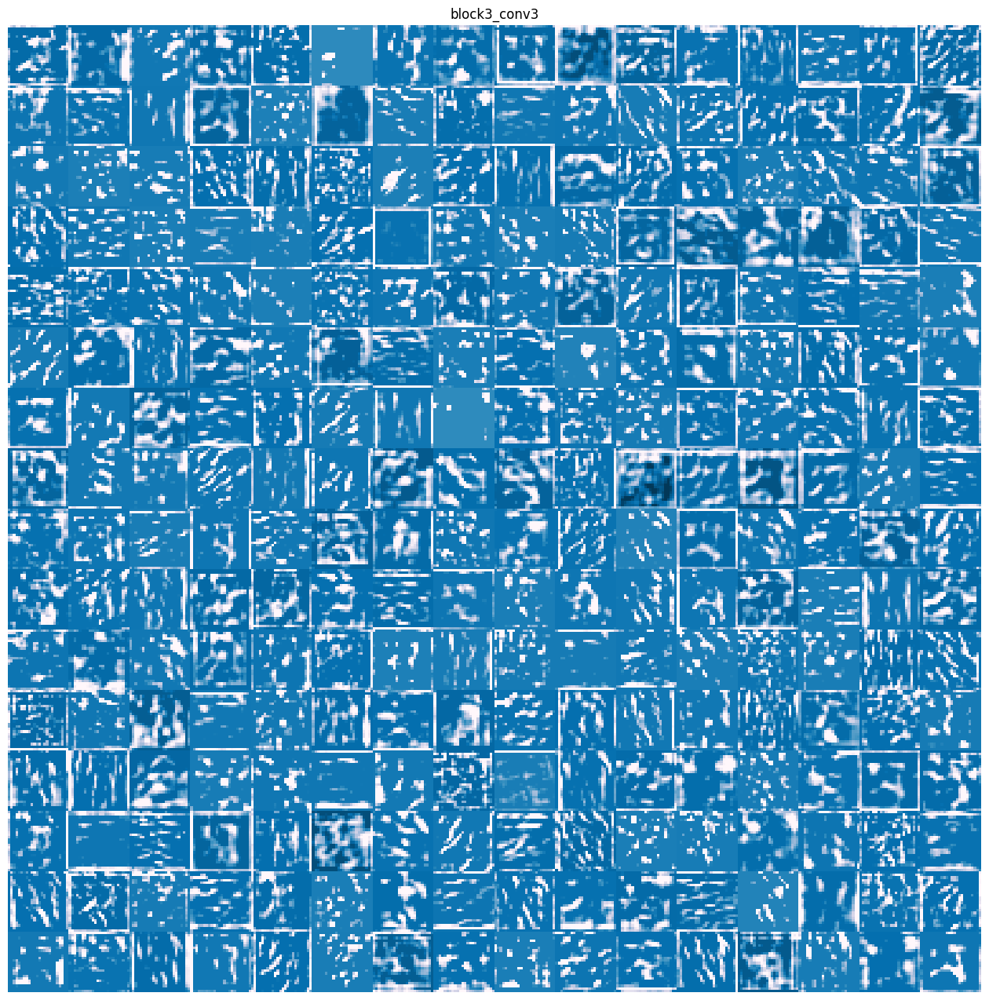

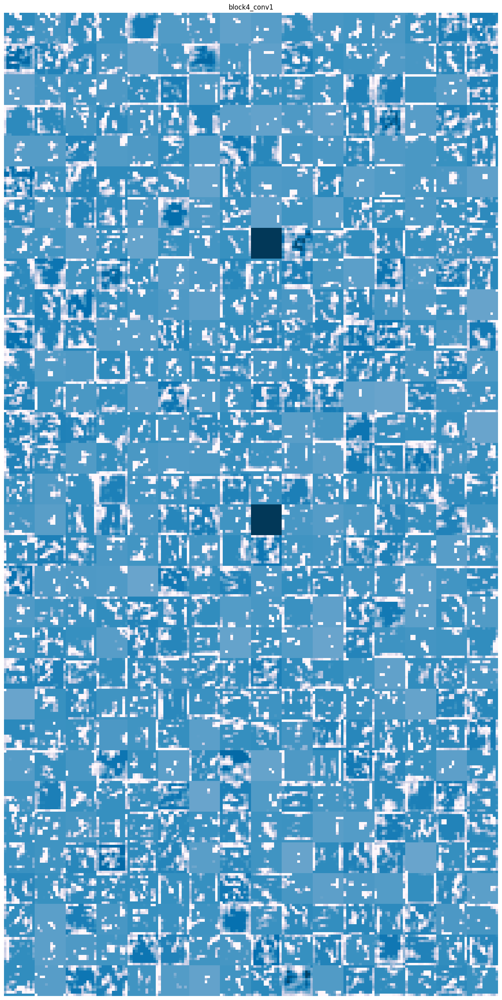

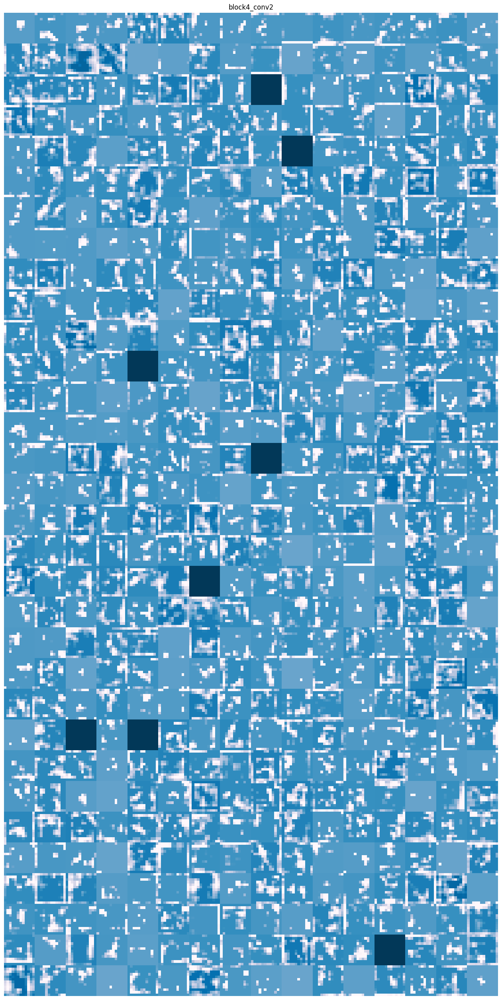

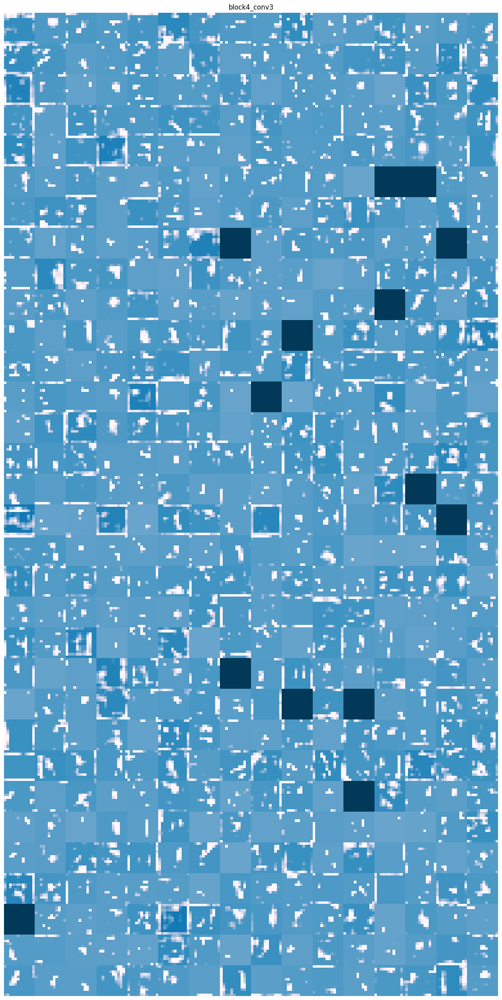

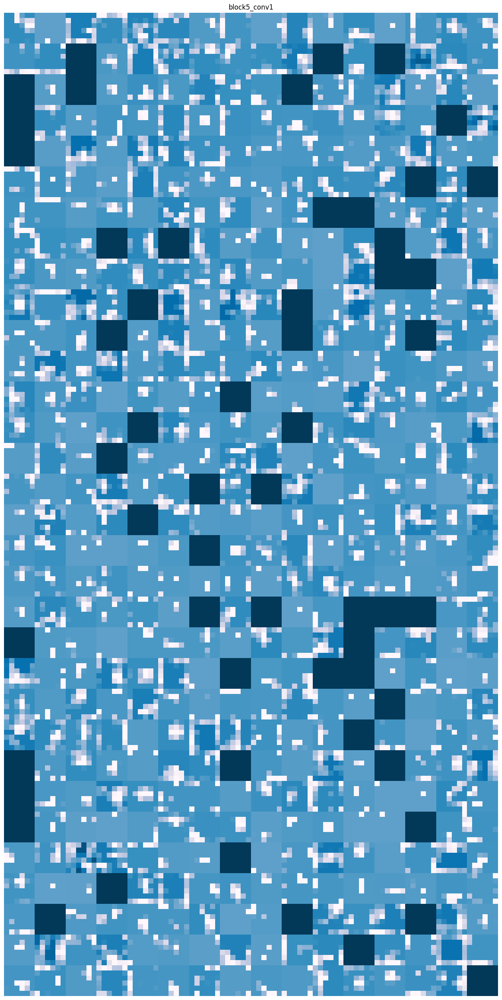

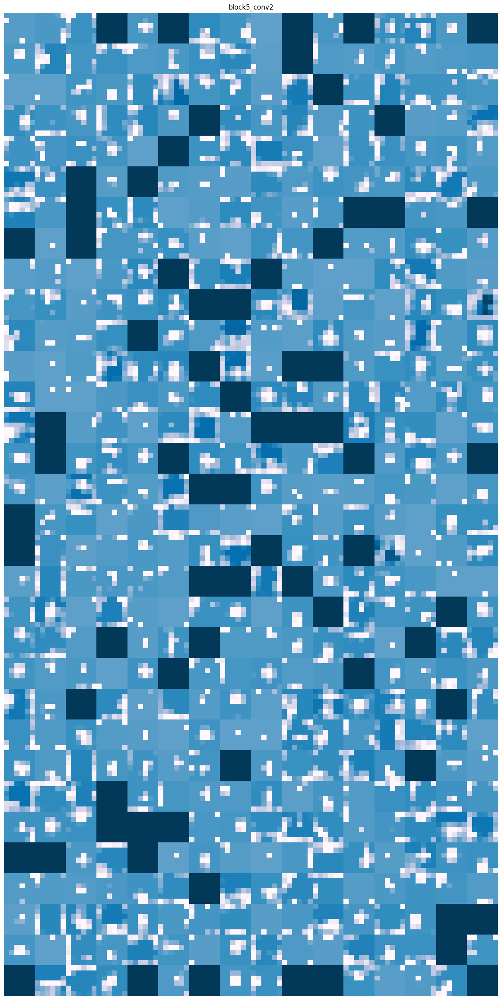

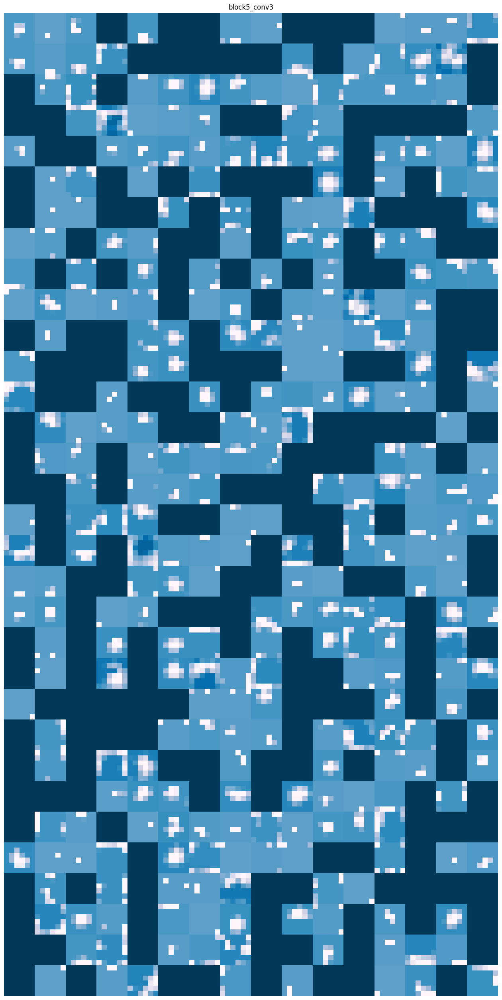

In [13]:
def show_activations(model, img):
    # Extrae las salidas de las 8 capas superiores:
    layer_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]
    # Crea un modelo que devuelva estas salidas a partir de la entrada:
    activation_model = tf.keras.models.Model(inputs=model.input, outputs=layer_outputs)

    # These are the names of the layers, so can have them as part of our plot
    layer_names = [layer.name for layer in model.layers if 'conv' in layer.name]

    activations = activation_model.predict(img)

    images_per_row = 16

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):

        # The feature map has shape (1, size, size, n_features)
        n_features = layer_activation.shape[-1]
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,
                                                 :, :,
                                                 col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,
                             row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.axis('off')
        plt.imshow(display_grid, aspect='auto', cmap='PuBu_r')

        plt.show()

show_activations(model, img_tensor)

#### Pregunta 2

Carga ahora un modelo entrenado para reconocer expresiones faciales usando finetunning con la VGG16 y vuelve a visualizar las activaciones de la imagen del perro

In [14]:
model_url = 'https://hdvirtual.us.es/discovirt/index.php/s/56Go2HStYwmrLmZ/download'
urllib.request.urlretrieve(model_url, 'face_expressions.keras')

face_model = tf.keras.models.load_model('./face_expressions.keras')

In [18]:
layer_face_outputs = [layer.output for layer in face_model.layers if 'conv' in layer.name]
activation_face_model = tf.keras.models.Model(inputs=face_model.input, outputs=layer_face_outputs)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


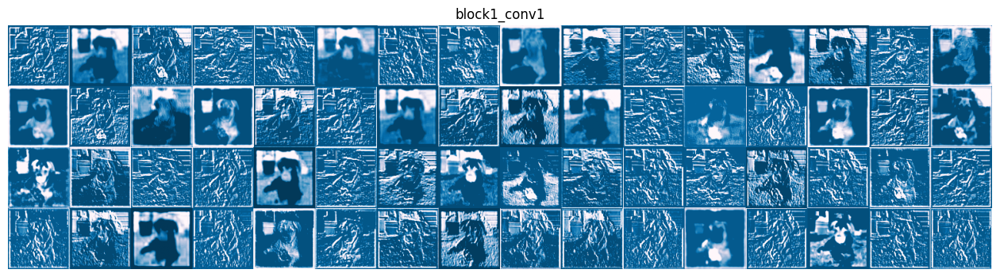

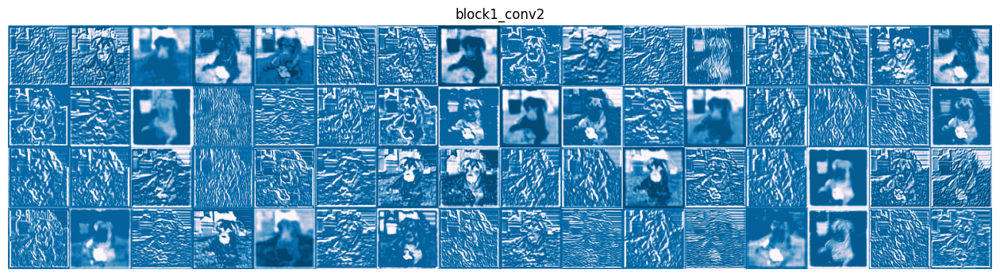

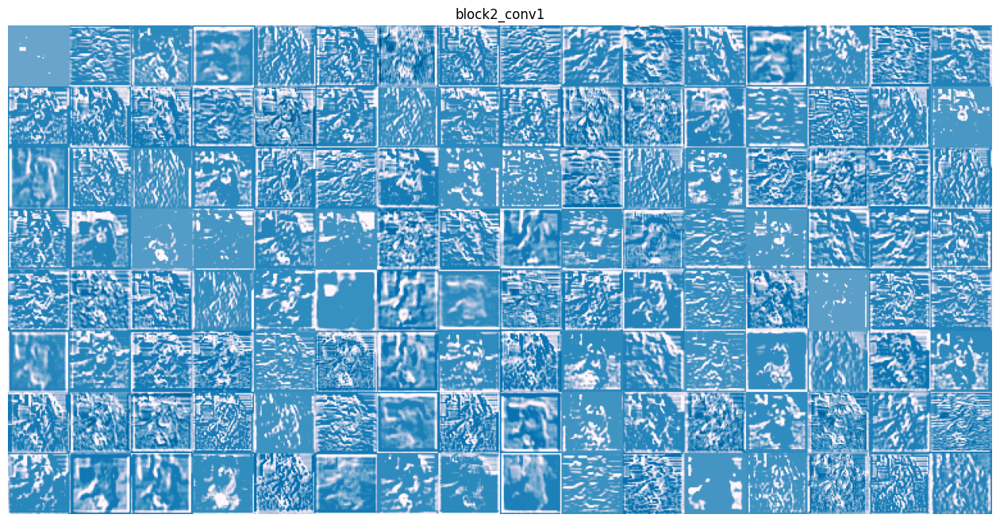

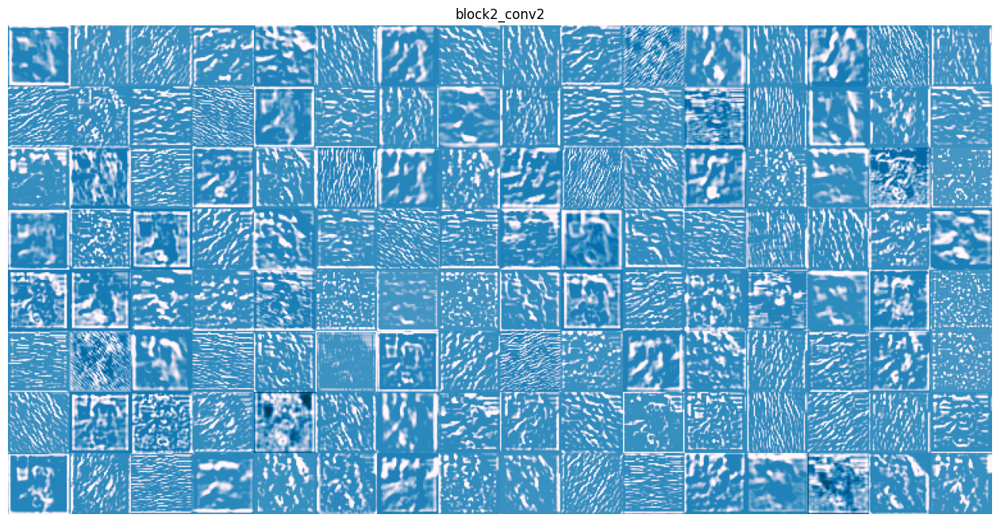

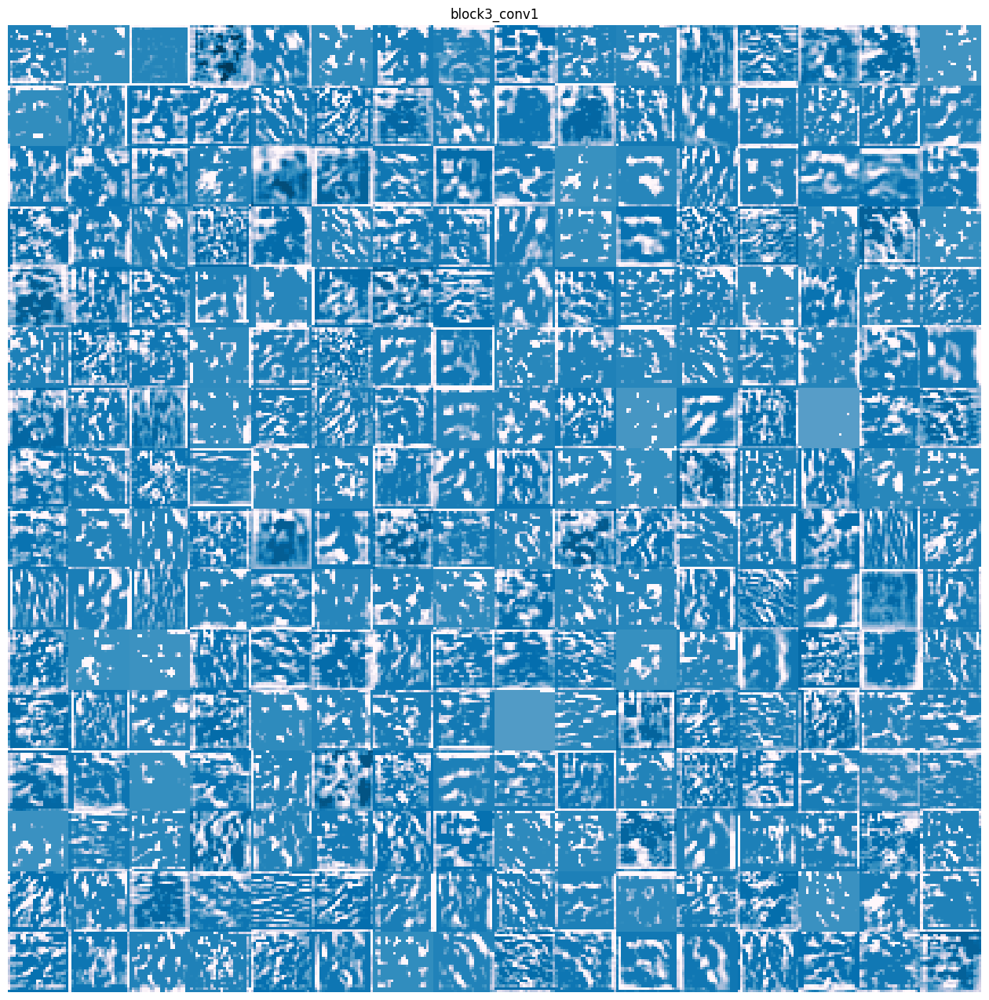

/var/folders/sl/6bh6kmv142759hyc6r3d8jqr0000gn/T/ipykernel_29319/1760294658.py:33: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
/var/folders/sl/6bh6kmv142759hyc6r3d8jqr0000gn/T/ipykernel_29319/1760294658.py:36: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


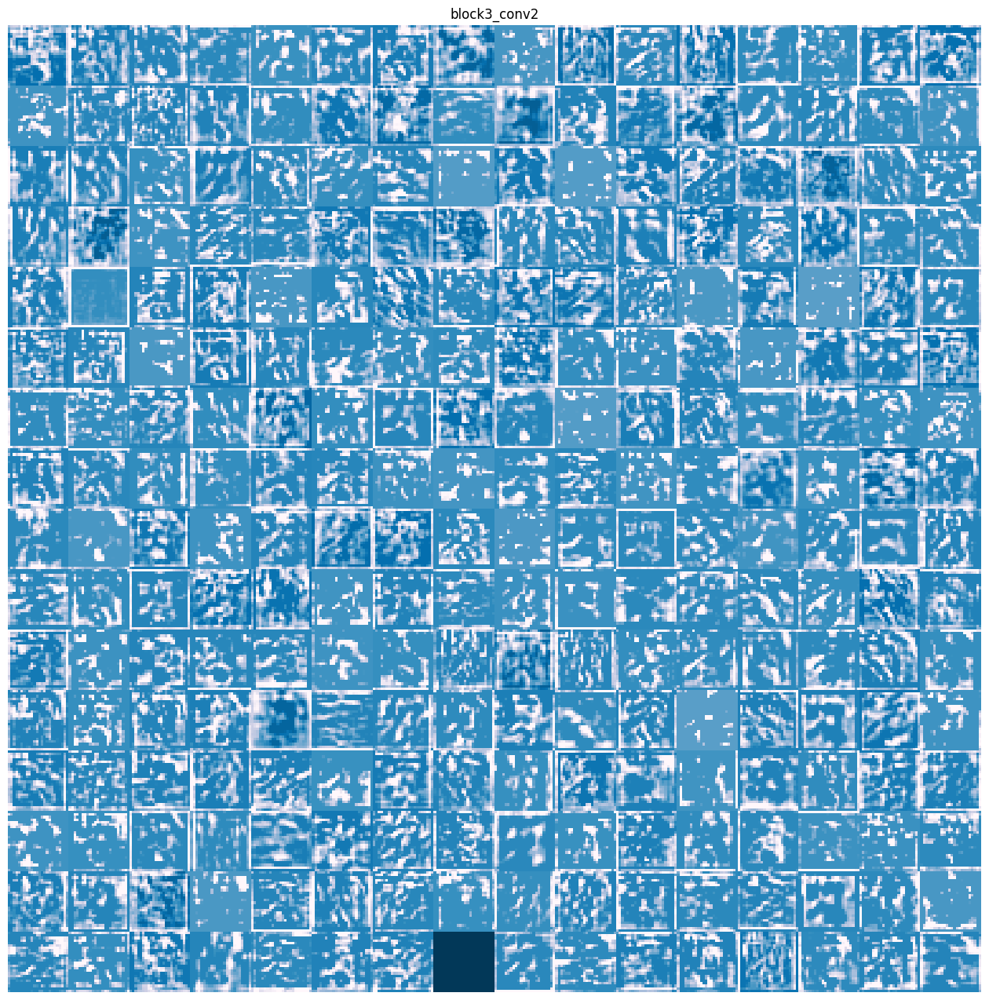

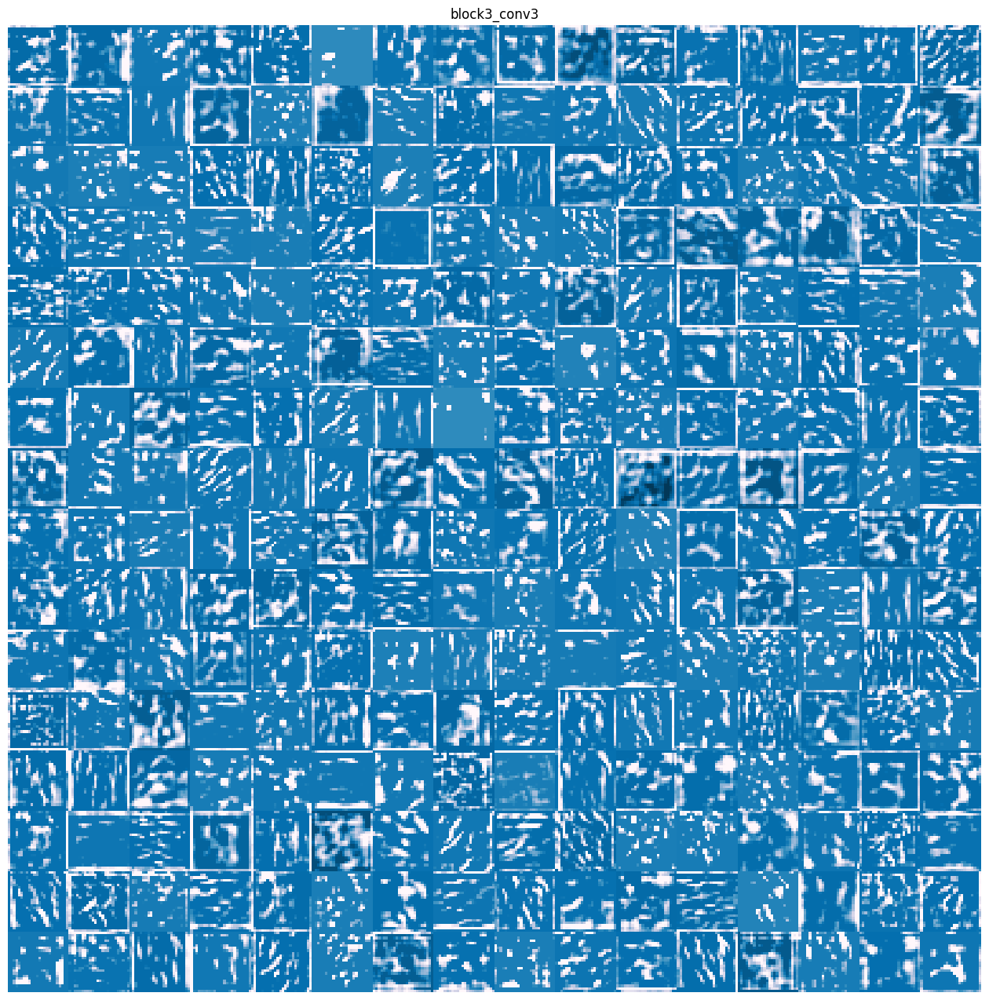

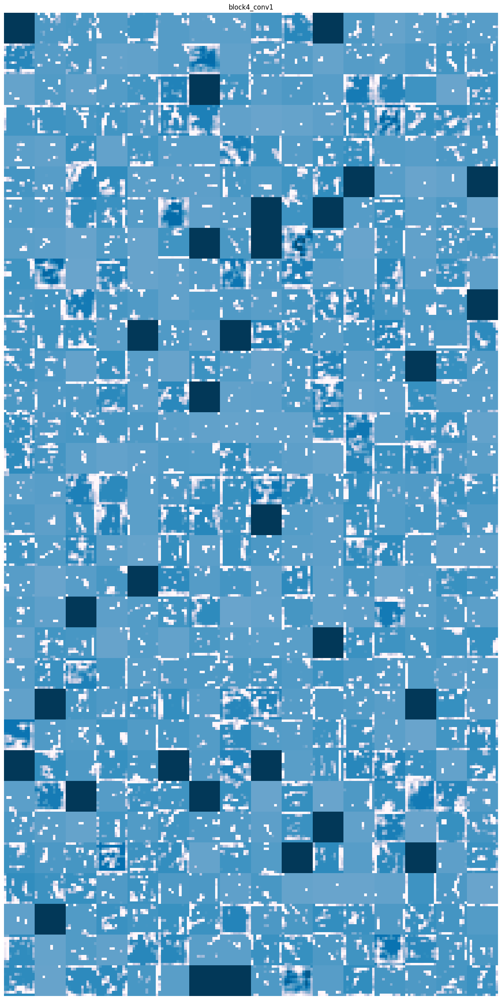

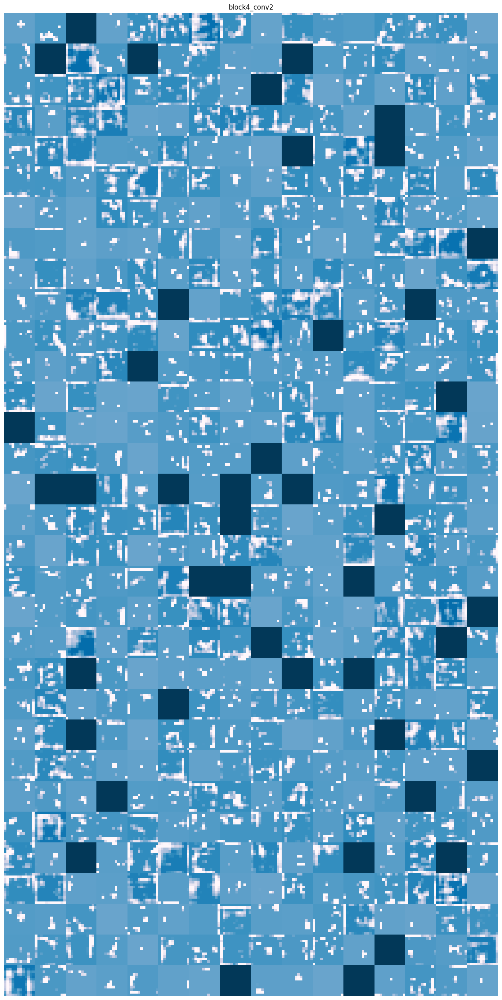

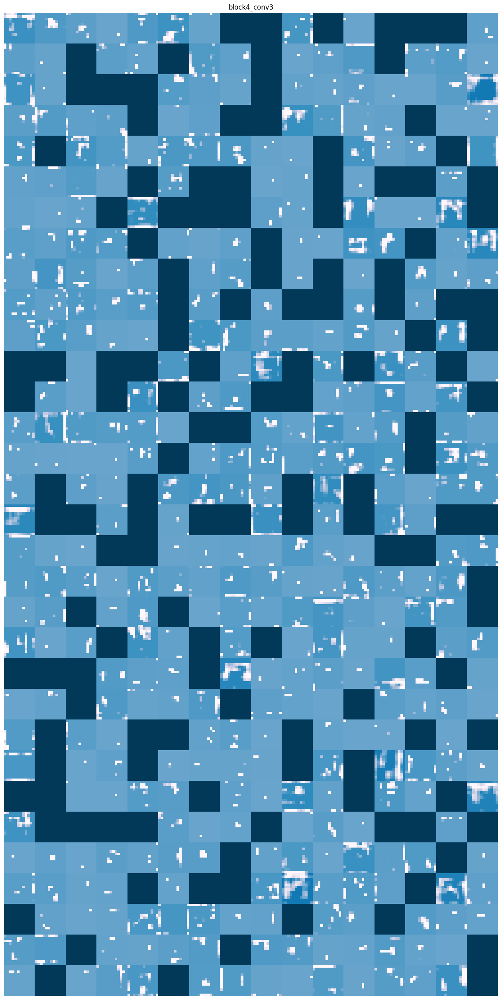

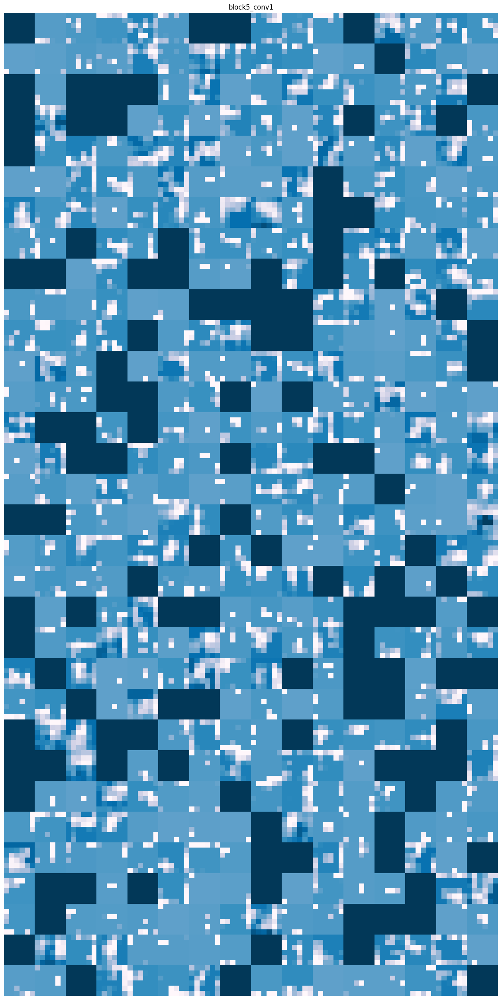

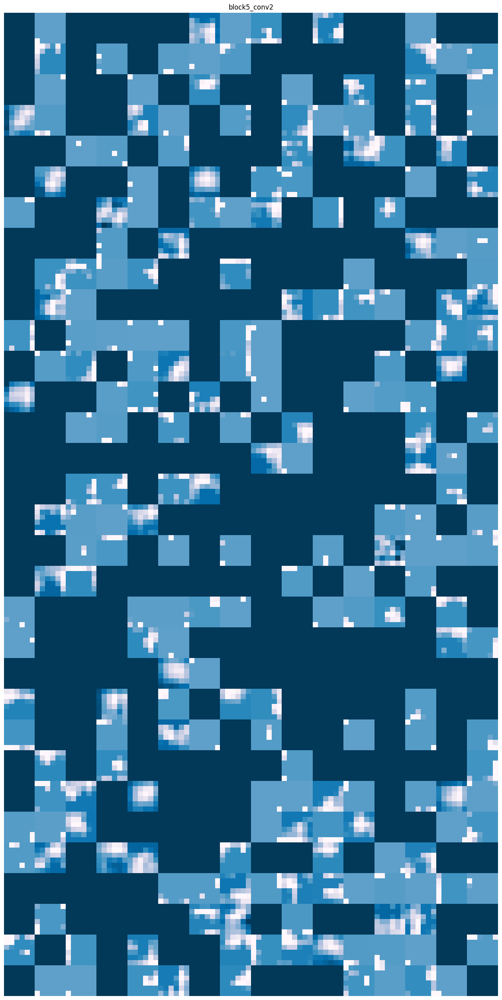

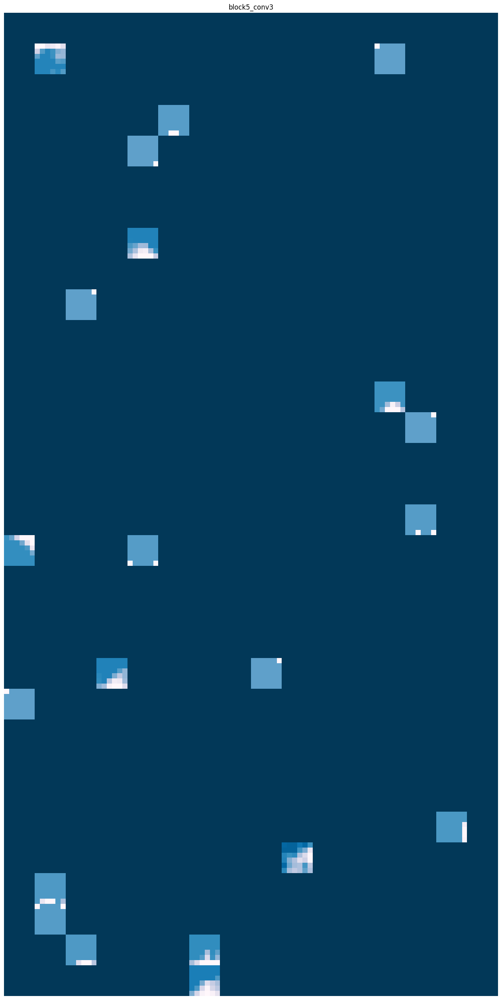

In [19]:
show_activations(face_model, img_tensor)

Pregunta 1.
Al pasar la imagen del perro por la VGG entrenada con para detectar expresiones faciales, ¿observas algo destacable en los mapas de características generados? si es así, ¿a que crees que se debe?
Observas alguna diferencia entre los mapas de las capas menos profunda con respecto a las capas más profundas en el caso anterior. Si es así, ¿a que crees que se debe?

Al pasar la fotografía de un perro por la red VGG16, previamente entrenada para la detección de rostros humanos, se observa que se activan muchos menos filtros en comparación con una imagen de una cara humana. Esto se debe a que los filtros han sido ajustados específicamente para reconocer patrones faciales humanos durante el entrenamiento, como ojos, boca o cejas. Dado que la imagen de un perro no pertenece al mismo dominio de entrenamiento, sus características morfológicas no coinciden con los patrones que la red ha aprendido a detectar, por lo que muchas neuronas permanecen inactivas. En otras palabras, la red no responde con la misma intensidad porque no ha sido entrenada para reconocer ese tipo de contenido visual.

### Pregunta 2

Busca ahora una imagen de una cara en internet. Leela y extrae los mapas de características.

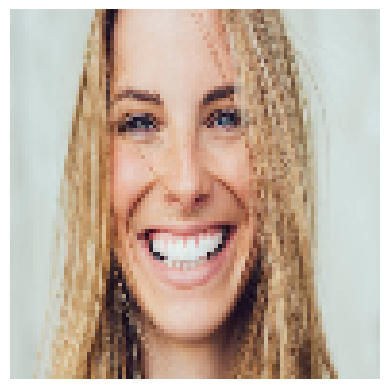

Expanded tensor shape: (1, 96, 96, 3)


In [29]:
url_img = "https://media.istockphoto.com/id/882495390/photo/happiness.jpg?s=612x612&w=0&k=20&c=SVUBI4k1eTLtc8rUcO4iWAgOo7SUcUdT8qOE7p3G9F8="
filename = "face.jpg"

urllib.request.urlretrieve(url_img, filename)

img_path = filename
img_tensor_face = cv2.imread(img_path)
img_tensor_face = cv2.cvtColor(img_tensor_face, cv2.COLOR_BGR2RGB)
img_tensor_face = cv2.resize(img_tensor_face, (96, 96))

plt.imshow(img_tensor_face)
plt.axis('off')
plt.show()

img_tensor_face = np.expand_dims(img_tensor_face, axis=0)
img_tensor_face = tf.keras.applications.vgg16.preprocess_input(img_tensor_face)

print('Expanded tensor shape:', img_tensor_face.shape)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step


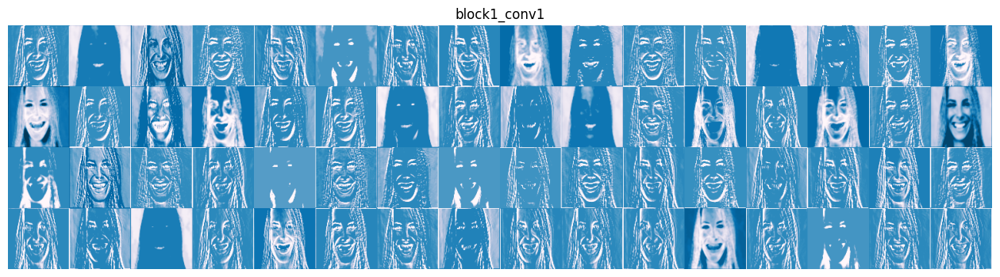

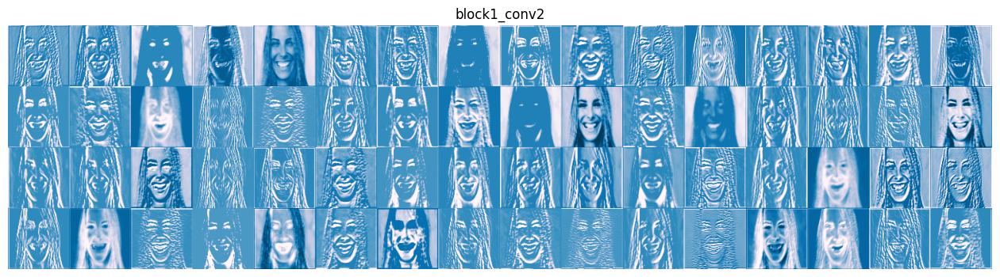

/var/folders/sl/6bh6kmv142759hyc6r3d8jqr0000gn/T/ipykernel_29319/1760294658.py:33: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
/var/folders/sl/6bh6kmv142759hyc6r3d8jqr0000gn/T/ipykernel_29319/1760294658.py:36: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


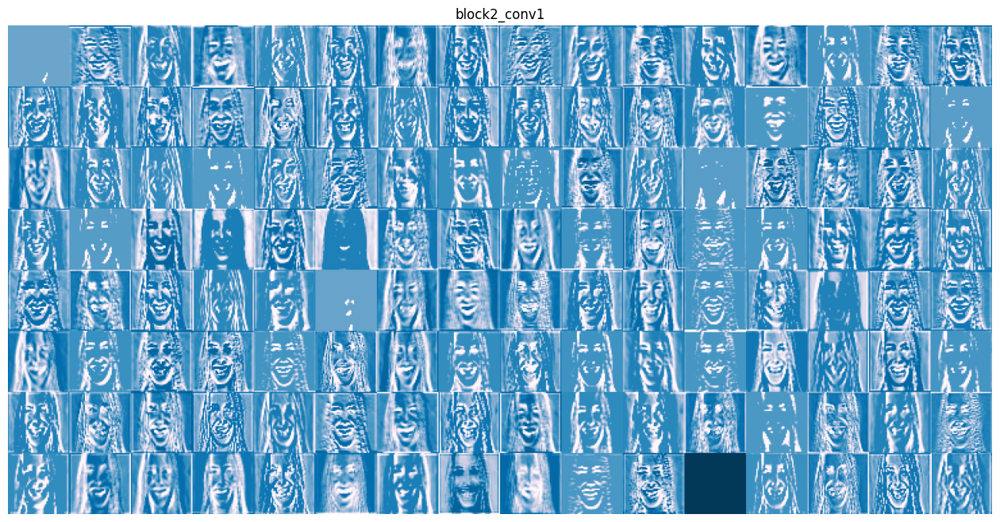

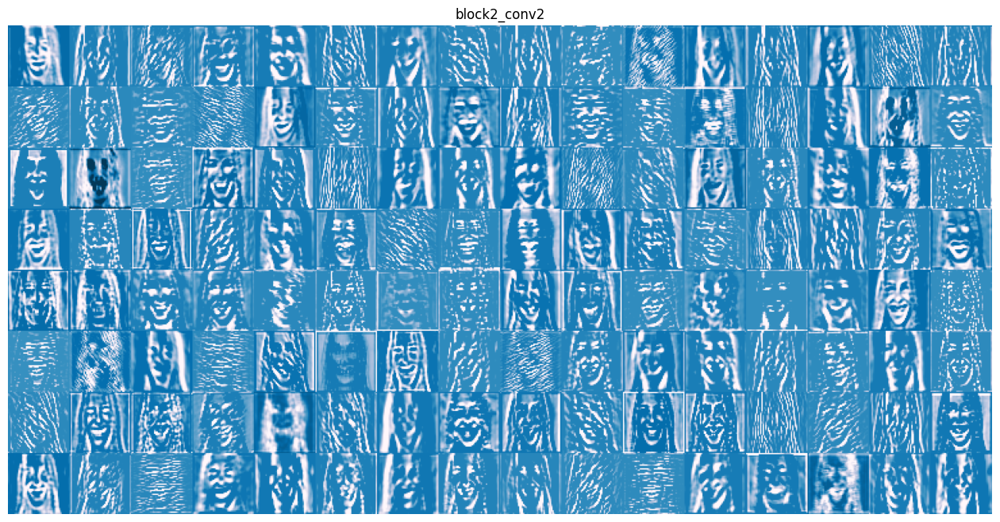

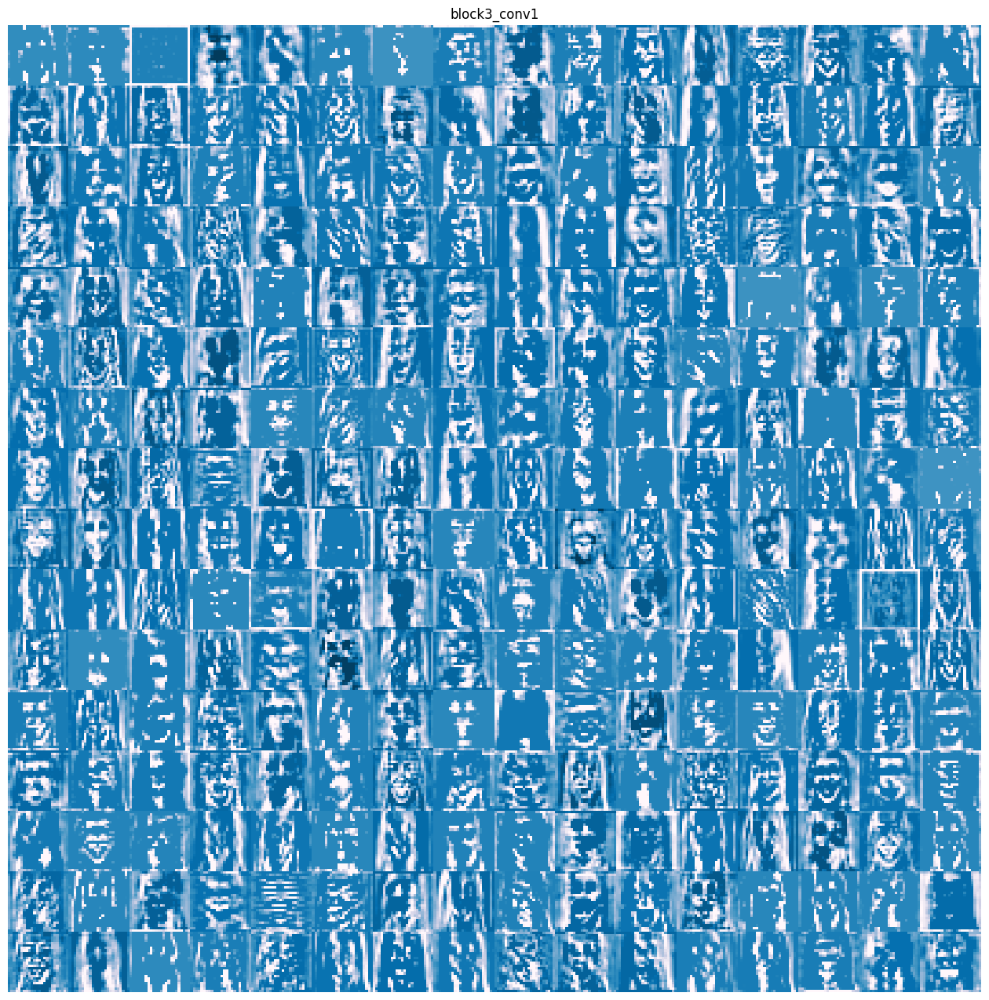

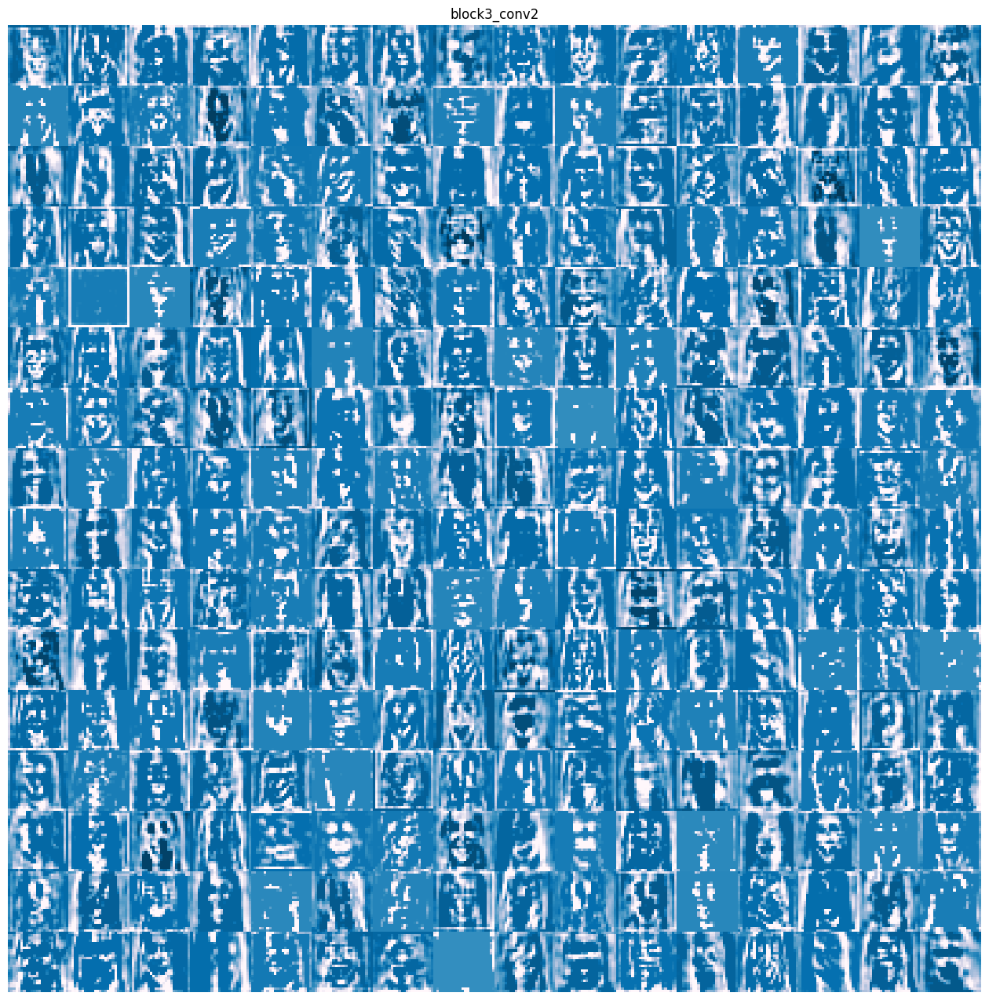

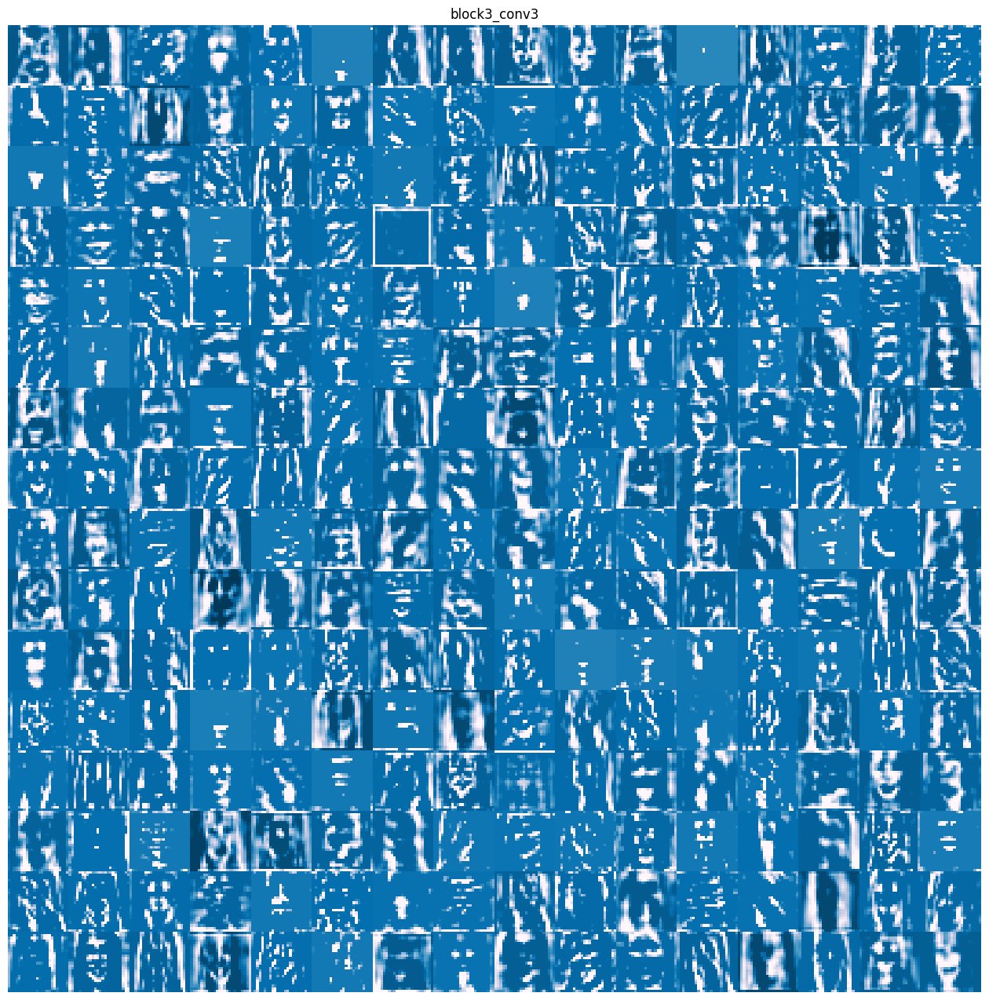

...

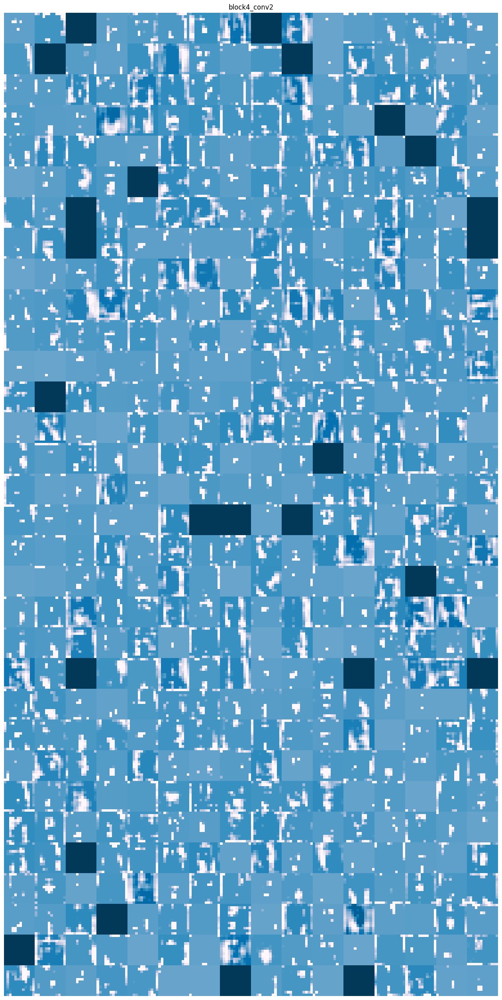

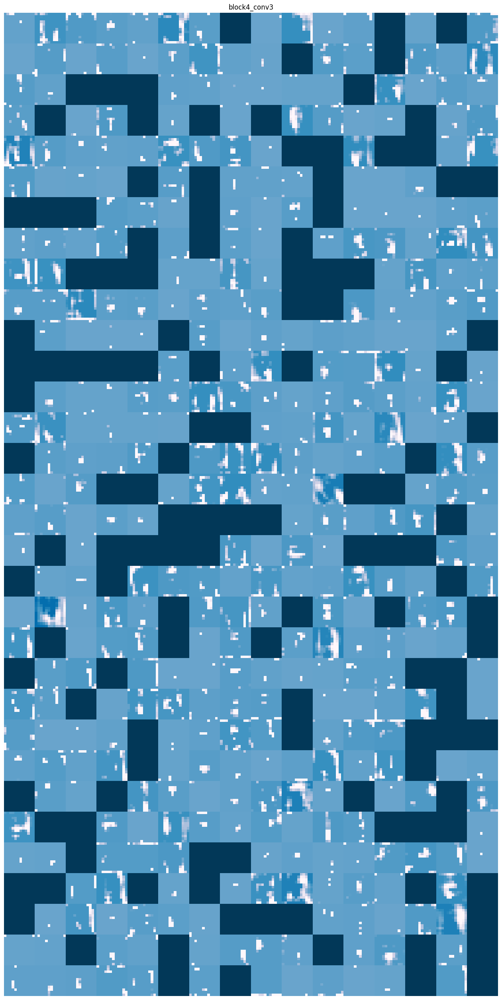

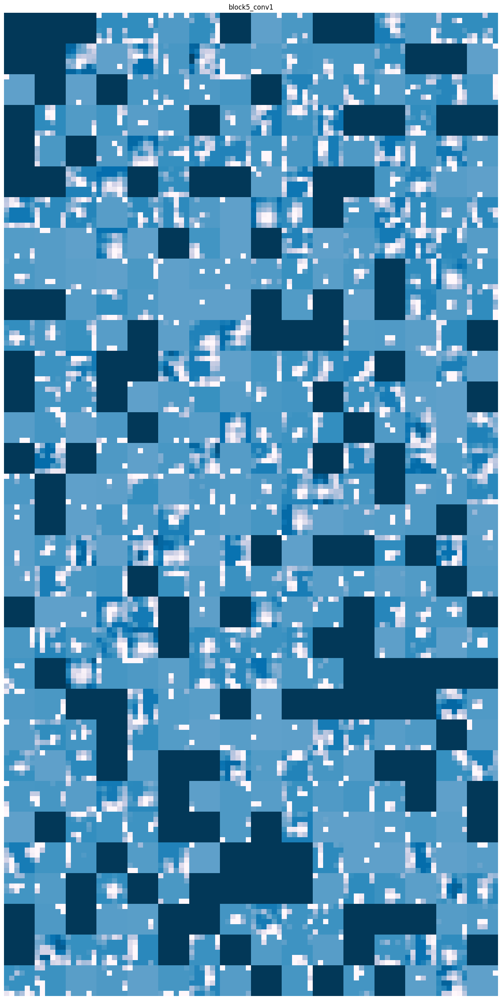

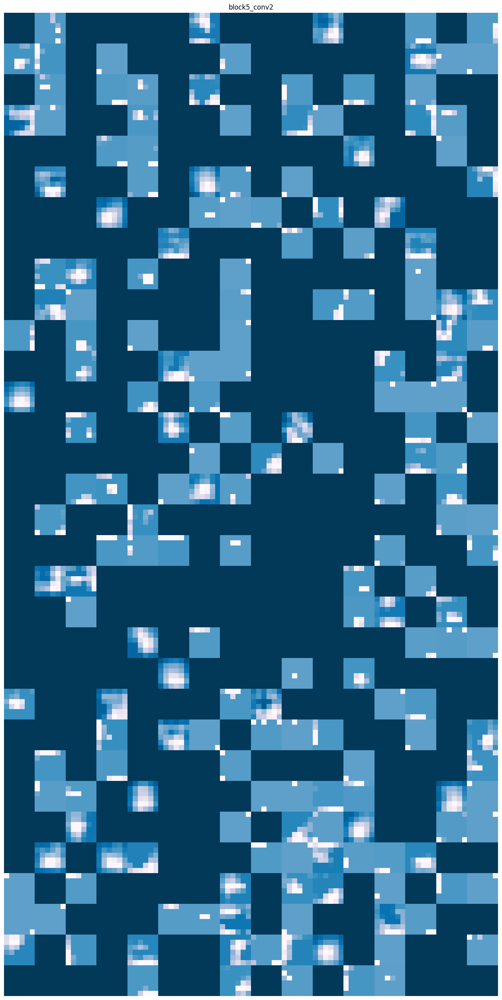

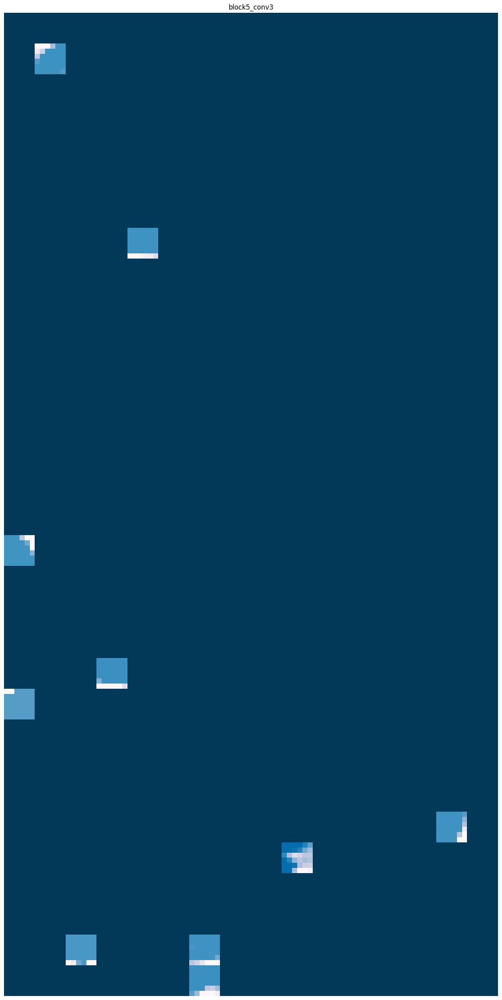

In [30]:
show_activations(face_model, img_tensor_face)

Pregunta 2.
Busca una imagen en internet de una persona sonriendo y extraer los mapas que se generan. Selecciona algunos mapas que consideres que son importantes para la predicción y subelos a la tarea junto con la imagen usada.

Me parece bastante interesante el block4_conv2 ya que le da especial interés a la parte de la boca, dado que el modelo esta entrenado para detectar las expresiones faciles, considero algo bastante lógico que se fije sobretodo en la sonria.